<div class="usecase-title">Night-time Saftey Index</div>

<div class="usecase-authors"><b>Authored by: Adithya Sentil</b> </div>

<div class="usecase-duration"><b>Duration:</b> 90 mins</div>

<div class="usecase-level-skill">
    <div class="usecase-level"><b>Level: </b>Intermediate</div>
    <div class="usecase-skill"><b>Pre-requisite Skills: </b>Python</div>
</div>

<header>
<h2>Scenario</h2>
<div> Melbourne is a vibrnt city with a 24h economy, as of a result transport authorities, city planners and concerned community members are increasingly worried about the night time saftey of the city. While melbourne has a thriving culture with many events, hospitality, shopping and public transport running late into the night. Not all parts of Melbourne is safe with the increased number of inccidents of crime occuring in city particularly in isolated walkways and streets with poor lighting. This raises concern in the community for the youth, elderly, women, students and shift workers alike. To address this problem, I have used the data from City of Melbourne open datasets. The implemented datasets include: 
- Street lighting 
- Pedestrian foot traffic 
- Public Transport stop locations. 

By developing the Night time saftey Index, I aim to identify areas within melbourne that are considered high risk zones. Areas in which there is low visibility, little to no street lights, little foot traffic and is not near a public transport stop. Conversly areas will be mared as safer if there is higher visibility, more foot traffic as this acts as a percieved layer of saftey  and access to public transport, as generally the likleyhood of people would be higher. The index is developed based on understanding crime data on low light and low populas areas. 

With the use of the Night-time saftey index, we can strive to improve these areas improve the saftey index and build a more safe and inclusive city for all members of the community.  </div>

As a student who commutes to the city regularly for work and univesity, I end up often traveling after dark. I want to know which areas in melbourne are safe or dangerous at night. So that I can plan a safer routes, avoid areas that are dangerous and feel confident that I will be safe moving through the city at night.

<div class="usecase-section-header">What this use case will teach you</div>

At the end of this use case you will:
- Demonstraite the ability to retrieve and process data from public API
- Data cleaning and preprocessing techniques on geospatial and time data
- Perform basic aggregation and filtering methods 
- Perform analysis using latitude and longitude data
- Implement data visualisation techniques 

## Introduction 
This use case aims to develop a Night time saftey index by combining datasets from the City of Melbourne Open data project. By combing the data, it can be then assessed and visualised to demonstrate the varying saftey level for different areas during the night hours. The project goal is to disover areas with low visablity, low foot traffic or infrastructure to aid in future developmenet to create a safer melbourne for all. The analysis is drawn from the datasets below accessed via the Melbourne open data API. By combining combining these datasets the project aims to create a data driven solution to create a safer and inclusive city.

Dataset Links 
- Bus Stops data link: https://data.melbourne.vic.gov.au/explore/dataset/bus-stops/api/  
- Street Lighting data link: https://data.melbourne.vic.gov.au/explore/dataset/street-lights-with-emitted-lux-level-council-owned-lights-only/api/
- Pedestrian counting link: https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-monthly-counts-per-hour/api/
- Feautured light data link: https://data.melbourne.vic.gov.au/explore/dataset/feature-lighting-including-light-type-wattage-and-location/api/


### Importing Required Libraries

In [13]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import requests
import os
from functools import reduce
import folium
from folium.plugins import HeatMap

### Importing Datasets 
Importing Dataset using API v2.1

In [15]:

def fetch_data(base_url, dataset, api_key, num_records=99, offset=0):
    all_records = []
    max_offset = 9900  # Maximum number of requests

    while True:
        # Maximum limit check
        if offset > max_offset:
            break

        # Create API request URL
        filters = f'{dataset}/records?limit={num_records}&offset={offset}'
        url = f'{base_url}{filters}&api_key={api_key}'

        # Start request
        try:
            result = requests.get(url, timeout=10)
            result.raise_for_status()
            records = result.json().get('results')
        except requests.exceptions.RequestException as e:
            raise Exception(f"API request failed: {e}")
        if records is None:
            break
        all_records.extend(records)
        if len(records) < num_records:
            break

        # Next cycle offset
        offset += num_records

    # DataFrame all data
    df = pd.DataFrame(all_records)
    return df



# Retrieve API key from environment variable
API_KEY = os.environ.get('MELBOURNE_API_KEY')
BASE_URL = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'

### Importing Council Owned Street light data 
Several key tasks are completed to prepare the street light dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 

In [17]:
# Data set name
dataset_street_lighting = 'street-lights-with-emitted-lux-level-council-owned-lights-only'

street_light_df = fetch_data(BASE_URL, dataset_street_lighting, API_KEY)
#Create a new col longitude 
street_light_df['longitude'] = street_light_df['geo_point_2d'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
#Create a new col latitude 
street_light_df['latitude'] = street_light_df['geo_point_2d'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)

print(street_light_df.head()) 


                                        geo_point_2d  \
0  {'lon': 144.98066700010136, 'lat': -37.8116730...   
1  {'lon': 144.9806740000221, 'lat': -37.81162799...   
2  {'lon': 144.9807329998954, 'lat': -37.81139499...   
3  {'lon': 144.98073799991442, 'lat': -37.8113810...   
4  {'lon': 144.9785690000381, 'lat': -37.81117199...   

                                           geo_shape prop_id  name addresspt1  \
0  {'type': 'Feature', 'geometry': {'coordinates'...       0  None        0.0   
1  {'type': 'Feature', 'geometry': {'coordinates'...       0  None        0.0   
2  {'type': 'Feature', 'geometry': {'coordinates'...       0  None        0.0   
3  {'type': 'Feature', 'geometry': {'coordinates'...       0  None        0.0   
4  {'type': 'Feature', 'geometry': {'coordinates'...       0  None        0.0   

  xorg ext_id asset_clas  label asset_type  ... addresspt asset_subt xsource  \
0  ESG  35350       None  0.684       None  ...         0       None    None   
1  ESG  35364   

### Data Quality Check: Invalid Geolocation and Missing Values

**Description:**

This cell performs essential data quality checks on the `street_light_df` DataFrame:

1. **Invalid Geolocation Entries:**  
   Filters and displays rows where the `geo_point_2d` field is *not* a dictionary. This helps identify malformed or inconsistent geolocation data.

2. **Dataset Summary:**  
   Prints a concise summary of the DataFrame’s structure, including column types and non-null counts using `.info()`.

3. **Missing Value Audit:**  
   Outputs the count of missing (null) values in each column to assess data completeness before proceeding with analysis or modeling.


In [19]:
# Filter and display rows where geo_point_2d is NOT a dictionary
invalid_geo_rows = street_light_df[~street_light_df['geo_point_2d'].apply(lambda x: isinstance(x, dict))]

# Display 
print(invalid_geo_rows[['geo_point_2d']])
print(street_light_df.info())

#Missing values in the dataset: 
print(street_light_df.isnull().sum())

Empty DataFrame
Columns: [geo_point_2d]
Index: []
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  9999 non-null   object 
 1   geo_shape     9999 non-null   object 
 2   prop_id       9999 non-null   object 
 3   name          0 non-null      object 
 4   addresspt1    9999 non-null   object 
 5   xorg          9999 non-null   object 
 6   ext_id        9999 non-null   object 
 7   asset_clas    0 non-null      object 
 8   label         9999 non-null   object 
 9   asset_type    0 non-null      object 
 10  easting       9999 non-null   object 
 11  northing      9999 non-null   object 
 12  str_id        9999 non-null   object 
 13  addresspt     9999 non-null   object 
 14  asset_subt    0 non-null      object 
 15  xsource       0 non-null      object 
 16  profile       0 non-null      object 
 17  xdate         9999 no


**Overview of `street_light_df`:**
- The dataset contains 9,999 entries and 23 columns.
- The structure was inspected using `.info()`, `.isnull().sum()`, and filtering for invalid structured geolocation data.

**Key Findings:**

1. No Invalid Geolocation Format:
   * The geo_point_2d column contains valid data for all 9,999 rows.
   * The filter for non-dictionary types returned an empty DataFrame, suggesting all entries conform to the expected structure.

2. High Number of Empty Fields:
   * Several columns such as name, asset_clas, asset_type, asset_subt, xsource, profile, and roadseg_id contain 0 non-null values.
   * These columns are likely irrelevant or deprecated and will be removed.

3. Complete Geolocation Data:
   - latitude and longitude columns have no missing values, confirming location data is fully populated.




### Cleaning and initialising Safety Scores for Street Light Data  
**Description:** 
The cell prepare the `street_light_df` DataFrame for analysis by: 

* Adding a new column named `safety_score`, assigning a default value of 1 to all rows. 
* Removing unnecessary columns related to geospatial metadata, internal identifies and classification details to simplify the dataset and retain only relavant features for further analysis. 

In [22]:
#Assigns value 1 to safety score for all longitude and latitude 
street_light_df['safety_score'] = 1 
street_light_df.drop(['prop_id', 'geo_point_2d','asset_type','addresspt','profile', 'geo_shape', 'name', 'addresspt1', 'xorg', 'ext_id', 'asset_clas', 'easting', 'northing', 'str_id', 'asset_subt', 'xsource', 'xdrawing', 'mcc_id', 'roadseg_id'], axis = 1, inplace = True)
street_light_df


,label,xdate,longitude,latitude,safety_score
0,0.684,20140916,144.980667,-37.811673,1
1,0.196,20140916,144.980674,-37.811628,1
2,3.715,20140916,144.980733,-37.811395,1
3,2.835,20140916,144.980738,-37.811381,1
4,3.03,20140916,144.978569,-37.811172,1
...,...,...,...,...,...
9994,5.376,20140916,144.964910,-37.811920,1
9995,4.594,20140916,144.966492,-37.815075,1
9996,99.022,20140916,144.963164,-37.807990,1
9997,99.316,20140916,144.963159,-37.807973,1


### Geospatial Visualisation of Street Lights 

**Description:** 

The scatter plot below plots the geographical distribution of street lights across the mapped area. Each point represents a single street light. 
Visualising provides a spatial context of the spread of the data and aids in discovering the light coverage and potential areas which are underlit. 

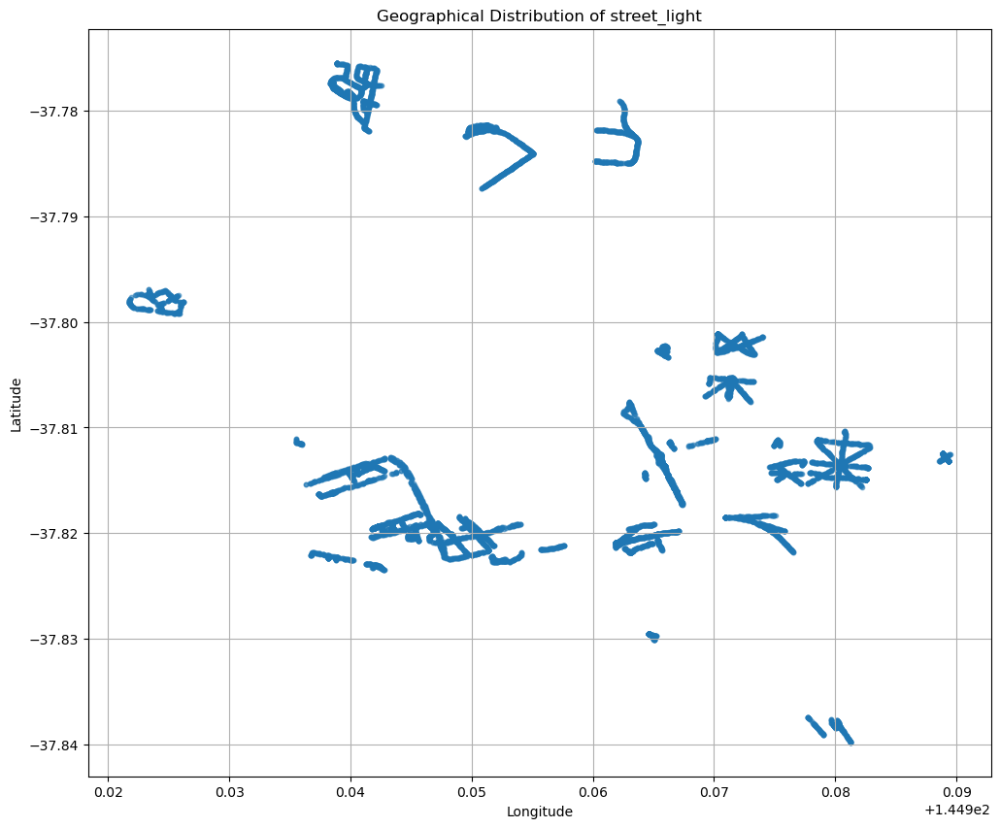

In [24]:

plt.figure(figsize=(12, 10))
plt.scatter(street_light_df['longitude'], street_light_df['latitude'], alpha=0.5, s=10
            )
plt.title('Geographical Distribution of street_light')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

**Overview of Geospatial visualisation:** 

The scatter plot has provided key insights into the datasets in particular the spread of the light datasets. As showen there are key areas that are missing that should be present when overlayed on a map of the city of melbourne. This takes into question the spread of the data what datasets are missing and what steps we cant take to account for the significant missing street light data. 

### Importing feature light data 
The data is fetched using the API and then the rows are renamed to latitude and longitude to keep consistant nameing porfile throughout all datasets.Enabling seamless geospatial analysis and integration with other location-based data 


In [27]:
# Data set name
feature_light_data = 'feature-lighting-including-light-type-wattage-and-location'
#Fetch data 
feature_light_df = fetch_data(BASE_URL, feature_light_data, API_KEY)
#Rename columns latitude and longitude 
feature_light_df.rename(columns={"lat": "latitude", "lon": "longitude"}, inplace= True)

feature_light_df


,asset_number,asset_description,lamp_type_lupvalue,lamp_rating_w,mounting_type_lupvalue,latitude,longitude,location
0,1544260,Feature Lighting - Birrarung Marr,13.0,70.0,Pole: Multiple Fixed,-37.818239,144.971382,"{'lon': 144.9713815748613, 'lat': -37.81823859..."
1,1541782,Feature Lighting -,13.0,35.0,Pole: Multiple Fixed,-37.822848,144.947094,"{'lon': 144.94709354140863, 'lat': -37.8228478..."
2,1542772,Feature Lighting -,12.0,NaN,Pole: Multiple Fixed,-37.823150,144.947204,"{'lon': 144.9472041813461, 'lat': -37.82314998..."
3,1346470,Feature Lighting - Docklands,1.0,NaN,Canopy,-37.817318,144.952251,"{'lon': 144.95225109118593, 'lat': -37.8173181..."
4,1539337,Feature Lighting - Newquay Promenade between S...,9.0,NaN,Pole: Multiple Fixed,-37.814603,144.942694,"{'lon': 144.94269431917522, 'lat': -37.8146026..."
...,...,...,...,...,...,...,...,...
8559,1347738,Feature Lighting - Docklands,1.0,18.0,Wall,-37.824620,144.946620,"{'lon': 144.94662008927858, 'lat': -37.8246201..."
8560,1541845,Feature Lighting -,NaN,NaN,Pole: Multiple Fixed,-37.823748,144.952091,"{'lon': 144.9520910323129, 'lat': -37.82374757..."
8561,1346811,Feature Lighting - Docklands,3.0,36.0,Parapet,-37.817528,144.950016,"{'lon': 144.95001579629215, 'lat': -37.8175284..."
8562,1544683,Feature Lighting - Seafarers Rest,2.0,14.0,Pole: Multiple Fixed,-37.822771,144.951655,"{'lon': 144.95165526864113, 'lat': -37.8227706..."


### Data Quality and Summary Statistics Overview 

**Description:** 

this code cell performs an intial analysis of the `feature_light_df` dataset to understand the completeness of the data and distribution. 

1. **Missing Value Check:** 
    * This is done with the use of `.isnull().sum()`, this displays the totoal number of missing values in each column. 
2. **Descriptive Statistics:** 
    * The `.describe()` method provides statisical summary. This aids in udnerstanding the data distributiona and will help in finidng and strange data. 
3. **Data Structure Summary:** 
    *  the `.info()` prints the data types, non-null counts and other data, helps in ensuring data types and further assists in finding feilds not much data. 


In [29]:
print("Missing values per column:")
print(feature_light_df.isnull().sum())
print(feature_light_df.describe()) 
print(feature_light_df.info())

Missing values per column:
asset_number                 0
asset_description            0
lamp_type_lupvalue        1093
lamp_rating_w             4458
mounting_type_lupvalue     611
latitude                     0
longitude                    0
location                     0
dtype: int64
       asset_number  lamp_type_lupvalue  lamp_rating_w     latitude  \
count  8.564000e+03         7471.000000    4106.000000  8564.000000   
mean   1.492630e+06            8.017401      52.039211   -37.818159   
std    8.554725e+04            4.428364      53.874435     0.006589   
min    1.346354e+06            1.000000       3.000000   -37.844649   
25%    1.487632e+06            3.000000      14.000000   -37.822813   
50%    1.540754e+06            9.000000      36.000000   -37.819194   
75%    1.542894e+06           13.000000      70.000000   -37.815231   
max    1.771404e+06           16.000000     500.000000   -37.786462   

         longitude  
count  8564.000000  
mean    144.952375  
std      

**Overview of `feature_light_df`:**
- The output provides a overview of the feature_light_df, column longitude and latitdue are fully populated providing a good foundation for further analysis. 

**Key Findings:**

1. Complete Geolocation Data:
   - latitude and longitude columns have no missing values, confirming location data is fully populated.

2. Missing Values:
   * Several columns such as lamp_type_lupvalue: 1093 missing, lamp_rating_w: 4458 missing values and mounting_type_lupvalue: 611 missing values.

3. Descriptive Statistics:
   - lamp_rating_w ranges from 3W to 500W with a median around 36W.


### Visualisation of Feature light's distribution of Lamp Wattage 

**Description:** 

The bar plot below visualises the distribution of lampwattage this gives us a visual representage of the light wattage. This will aid in deciding on the weightage of the safety score based on the light wattage.

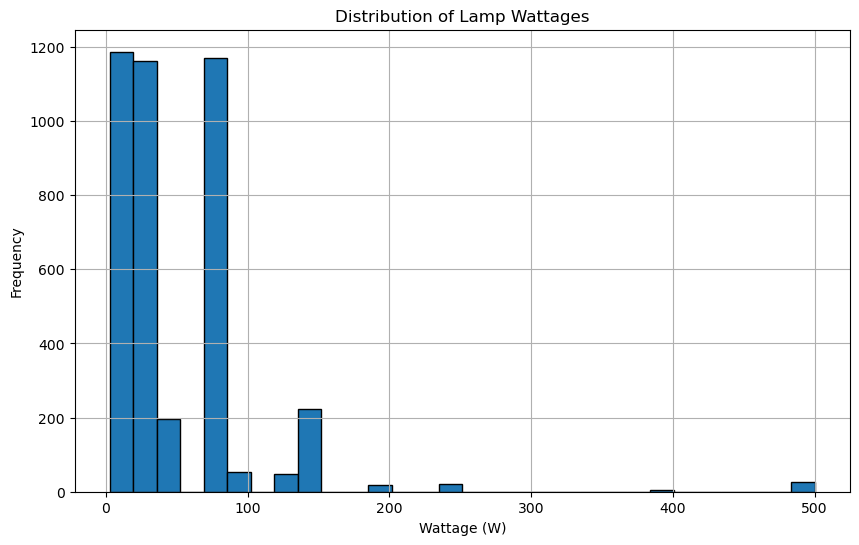

In [32]:

plt.figure(figsize=(10,6))
plt.hist(feature_light_df['lamp_rating_w'].dropna(), bins=30, edgecolor='black')
plt.title('Distribution of Lamp Wattages')
plt.xlabel('Wattage (W)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

### Wattage Distribution Insight

**Observation:**  
The majority of street lights in the `feature_light_df` dataset fall within the 0–100 watt range, with a few number exceeding 400 watts. With the distribution skewed to the left it suggests a intentional design strategy in urban lighting infrastructure assuming it is based on the density of the location.

**Interpretation:**  
The relatively low wattage per individual light may reflect a higher density based method with a higher concentration of lights, as each light require less power to produce sufficient illumination. This enables:
    * Better energy efficiency
    * Reduced light pollution
     *Even light distribution across high-density areas

**Implication for Analysis:**  
When evaluating visibility within an area, it is essential to taken into concideration both individual lamp wattage and the spatial density of lighting. 



### Initialising `safety_score` for feature_light_df and Cleaning

**Description:** 

* The safety score is attatched to the feature_light_df with the assignement based on the lamp_rating_w this checkes the range of the wattage of each light and then assings a safety score. 
* As we can see below if the light is below 50w the rating is 1, if the light is below 100 we get a safety rating of 2, if the light is below  300w we get a saftey rating of 3 and for anything above we get a safety rating of 4. If there is a missing value we return 1 for the rating of the light. As it is most likely to be that of 50w or less. 

* Finally we can see below that `.drop()` removes columns that are not used within the dataset so that it can be cleaned and be more clear. 



In [35]:
feature_light_df['safety_score'] = feature_light_df['lamp_rating_w'].apply(
    lambda x: 1 if x < 50 else 2 if x < 100 else 3 if x < 300 else 4 if x < 1000 else 1
)

feature_light_df.drop(['lamp_type_lupvalue','mounting_type_lupvalue', 'location'], axis= 1, inplace= True)
feature_light_df

,asset_number,asset_description,lamp_rating_w,latitude,longitude,safety_score
0,1544260,Feature Lighting - Birrarung Marr,70.0,-37.818239,144.971382,2
1,1541782,Feature Lighting -,35.0,-37.822848,144.947094,1
2,1542772,Feature Lighting -,NaN,-37.823150,144.947204,1
3,1346470,Feature Lighting - Docklands,NaN,-37.817318,144.952251,1
4,1539337,Feature Lighting - Newquay Promenade between S...,NaN,-37.814603,144.942694,1
...,...,...,...,...,...,...
8559,1347738,Feature Lighting - Docklands,18.0,-37.824620,144.946620,1
8560,1541845,Feature Lighting -,NaN,-37.823748,144.952091,1
8561,1346811,Feature Lighting - Docklands,36.0,-37.817528,144.950016,1
8562,1544683,Feature Lighting - Seafarers Rest,14.0,-37.822771,144.951655,1


### Analysis Summary

**Safety Score Implementation:**  
The `safety_score` has been successfully computed and assigned based on the `lamp_rating_w` values, reflecting the relative illumination capacity of each feature light.

**Data Cleaning:**  
Unnecessary columns such as `lamp_type_lupvalue`, `mounting_type_lupvalue`, and `location` have been removed from `feature_light_df` to streamline the dataset and focus on relevant variables.

**Outcome:**  
The dataset is now clean, well-structured, and ready for further exploratory analysis or integration with other spatial and pedestrian datasets.


### Importing city circle tram stop data 
Several key tasks are completed to prepare tram stop dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 

In [38]:
# Data set name
tram_stops = 'city-circle-tram-stops'
# Fetch dataset 
city_circle_tram_stops = fetch_data(BASE_URL, tram_stops, API_KEY)
# Create a new row named latitude
city_circle_tram_stops['latitude'] = city_circle_tram_stops['geo_point_2d'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)

# Create a new row named longitude
city_circle_tram_stops['longitude'] = city_circle_tram_stops['geo_point_2d'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
# Create a new row named longitude


print(city_circle_tram_stops.head())


                                        geo_point_2d  \
0  {'lon': 144.95786314283018, 'lat': -37.8202377...   
1  {'lon': 144.95546153614245, 'lat': -37.8209726...   
2  {'lon': 144.95109855638137, 'lat': -37.8219046...   
3  {'lon': 144.95644059700524, 'lat': -37.8117714...   
4  {'lon': 144.95891745116262, 'lat': -37.8110592...   

                                           geo_shape  \
0  {'type': 'Feature', 'geometry': {'coordinates'...   
1  {'type': 'Feature', 'geometry': {'coordinates'...   
2  {'type': 'Feature', 'geometry': {'coordinates'...   
3  {'type': 'Feature', 'geometry': {'coordinates'...   
4  {'type': 'Feature', 'geometry': {'coordinates'...   

                                   name      xorg stop_no mccid_str  xsource  \
0  Melbourne Aquarium / Flinders Street  GIS Team       2      None  Mapbase   
1      Spencer Street / Flinders Street  GIS Team       1      None  Mapbase   
2       The Goods Shed / Wurundjeri Way  GIS Team      D5      None  Mapbase   
3     

### Data Quality and Summary Statistics Overview 

**Description:** 

this code cell performs an intial analysis of the `city_circle_tram_stops` dataset to understand the completeness of the data and distribution. 

1. **Missing Value Check:** 
    * This is done with the use of `.isnull().sum()`, this displays the totoal number of missing values in each column. 
2. **Descriptive Statistics:** 
    * The `.describe()` method provides statisical summary. This aids in udnerstanding the data distributiona and will help in finidng and strange data. 
3. **Data Structure Summary:** 
    *  the `.info()` prints the data types, non-null counts and other data, helps in ensuring data types and further assists in finding feilds not much data. 

In [40]:
print(city_circle_tram_stops.describe())
print("Missing data")
print(city_circle_tram_stops.isnull().sum())

print(city_circle_tram_stops.info())

        latitude   longitude
count  28.000000   28.000000
mean  -37.814679  144.959475
std     0.004571    0.010734
min   -37.822157  144.938646
25%   -37.818407  144.951395
50%   -37.814528  144.960143
75%   -37.810883  144.969134
max   -37.807603  144.974534
Missing data
geo_point_2d     0
geo_shape        0
name             0
xorg             0
stop_no          0
mccid_str       28
xsource          0
xdate            0
mccid_int        0
latitude         0
longitude        0
dtype: int64
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28 entries, 0 to 27
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   geo_point_2d  28 non-null     object 
 1   geo_shape     28 non-null     object 
 2   name          28 non-null     object 
 3   xorg          28 non-null     object 
 4   stop_no       28 non-null     object 
 5   mccid_str     0 non-null      object 
 6   xsource       28 non-null     object 
 7   xdate    

**Overview of `city_circle_tram_stops`:**
- The output provides a overview of the city_circle_tram_stops, column longitude and latitdue are fully populated providing a good foundation for further analysis. 

**Key Findings:**

1. Complete Geolocation Data:
   * latitude and longitude columns have no missing values, confirming location data is fully populated.

2. Missing Values:
   * mccid_str is missing 28 data values everythin else seems to have no null values

3. Descriptive Statistics:
   * there are 28 entries of data points

### Safety Score assignment and Cleaning

**Description:** 

The code cell below provides a safety score of 3 to all tram stops as each one is of equal importance. As there are not many tram stops within the city loop these stops tend to be places of interest. 
It is key to  understand the locations tend to be high traffic and will be utilised by many to be transported throughout the city. 

the dataset is then cleaned by dropping unwanted columns 



In [43]:
city_circle_tram_stops['safety_score'] = 3 
city_circle_tram_stops.drop(['geo_point_2d', 'geo_shape', 'xorg', 'mccid_str', 'xsource', 'xdate', 'mccid_int'], axis= 1, inplace=True)

city_circle_tram_stops

,name,stop_no,latitude,longitude,safety_score
0,Melbourne Aquarium / Flinders Street,2,-37.820238,144.957863,3
1,Spencer Street / Flinders Street,1,-37.820973,144.955462,3
2,The Goods Shed / Wurundjeri Way,D5,-37.821905,144.951099,3
3,William Street / La Trobe Street,3,-37.811771,144.956441,3
4,Queen Street / La Trobe Street,4,-37.811059,144.958917,3
5,Swanston Street / La Trobe Street,6,-37.809619,144.963850,3
6,Russell Street / La Trobe Street,7,-37.808877,144.966345,3
7,Parliament / Collins Street,8,-37.813581,144.974064,3
8,Swanston Street / Flinders Street,5,-37.817632,144.966905,3
9,Elizabeth Street / Flinders Street,4,-37.818324,144.964479,3


City circle tram stops saftey score is allocated based on the fact that the city circle is quite a busy area with high foot traffic and it allows for easy pathway throughout the city many of which people can you to travel directly home or to a train station to get said individual home. As the city circle is always well lit and has a large foot traffic each stop has been allocated a safety score of 3 which is quite high. 

### Importing Pedestrian Counting data 
Several key tasks are completed to prepare the Pedestrian counting dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 


In [46]:
# Data set name
dataset_pedestrian_counting = 'pedestrian-counting-system-monthly-counts-per-hour'
# Fetch dataset 
pedestrian_counting_df = fetch_data(BASE_URL, dataset_pedestrian_counting, API_KEY)
# Create a new row named latitude
pedestrian_counting_df['latitude'] = pedestrian_counting_df['location'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)
# Create a new row named longitude
pedestrian_counting_df['longitude'] = pedestrian_counting_df['location'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)

pedestrian_counting_df.head(20)

,id,location_id,sensing_date,hourday,direction_1,direction_2,pedestriancount,sensor_name,location,latitude,longitude
0,671120211218,67,2021-12-18,11,236,248,484,FLDegS_T,"{'lon': 144.96562569, 'lat': -37.81688755}",-37.816888,144.965626
1,121320240523,12,2024-05-23,13,188,164,352,NewQ_T,"{'lon': 144.94292398, 'lat': -37.81457988}",-37.814580,144.942924
2,1371820250124,137,2025-01-24,18,11,37,48,BouHbr2353_T,"{'lon': 144.94612292, 'lat': -37.81894815}",-37.818948,144.946123
3,1661720250421,166,2025-04-21,17,65,71,136,Spen484_T,"{'lon': 144.94931703, 'lat': -37.80896733}",-37.808967,144.949317
4,531220210901,53,2021-09-01,12,144,131,275,Col254_T,"{'lon': 144.965499, 'lat': -37.81564191}",-37.815642,144.965499
5,6320250215,6,2025-02-15,3,42,48,90,FliS_T,"{'lon': 144.96558255, 'lat': -37.81911705}",-37.819117,144.965583
6,581620220329,58,2022-03-29,16,394,566,960,Bou688_T,"{'lon': 144.95358075, 'lat': -37.81686075}",-37.816861,144.953581
7,5920230903,5,2023-09-03,9,234,328,562,PriNW_T,"{'lon': 144.96787656, 'lat': -37.81874249}",-37.818742,144.967877
8,49420240116,49,2024-01-16,4,16,19,35,Eli501_T,"{'lon': 144.95956055, 'lat': -37.80730068}",-37.807301,144.959561
9,592320220507,59,2022-05-07,23,88,30,118,RMIT_T,"{'lon': 144.96304859, 'lat': -37.80825648}",-37.808256,144.963049


### Exploritory Pedestrian Activity Patterns
The data is investigated to develop a better understanding on the data and to build better insights into the statistics. To understand the foot traffic across Melbourne at various points in the day, I analyse the Pedestrian counting system dataset, the sensor provides hourly pedestrain counts caputed through sensors placed in various locations throughout the city. The first step that is carried out is the maximum and minimum pedestrian volumes. This allows me to identify the busiest and the quietest recored counts, including their exact location and hour of the day the data was collected. 
date_time is a sorted time seried by sensing_date, hourday and location_id to allow for time trend analysis which time are busier and which are not. 
Finally the data is grouped by sensor_name, sensing_date and hourday to be implemented in more advance data aggregation. 


In [48]:
max_count = pedestrian_counting_df['pedestriancount'].max() 
min_count = pedestrian_counting_df['pedestriancount'].min()  
busiest_loc = pedestrian_counting_df.loc[pedestrian_counting_df['pedestriancount'].idxmax()][['latitude', 'longitude', 'hourday']]
quietest_loc = pedestrian_counting_df.loc[pedestrian_counting_df['pedestriancount'].idxmin()][['latitude', 'longitude', 'hourday']]
date_time = pedestrian_counting_df.sort_values(['sensing_date', 'hourday', 'location_id'])
group_ped_data = pedestrian_counting_df.groupby(['sensor_name', 'sensing_date', 'hourday'])
print(pedestrian_counting_df.info()) 
print(date_time)

print(max_count)
print(min_count)
print(busiest_loc)
print(quietest_loc)


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9999 entries, 0 to 9998
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   id               9999 non-null   int64  
 1   location_id      9999 non-null   int64  
 2   sensing_date     9999 non-null   object 
 3   hourday          9999 non-null   int64  
 4   direction_1      9999 non-null   int64  
 5   direction_2      9999 non-null   int64  
 6   pedestriancount  9999 non-null   int64  
 7   sensor_name      9999 non-null   object 
 8   location         9999 non-null   object 
 9   latitude         9999 non-null   float64
 10  longitude        9999 non-null   float64
dtypes: float64(2), int64(6), object(3)
memory usage: 859.4+ KB
None
                id  location_id sensing_date  hourday  direction_1  \
4175   52620210701           52   2021-07-01        6           10   
712    12720210701           12   2021-07-01        7           26   
9702   209202107

### Safety Score Assignment 

**Description:** 
* The data is first grouped by `location_id`, `latitude` and `longitude` to discover the the `pedestriancount` which sums the total value from all times of a day to provide a respresentative value to determine how busy each of the pedestrian count locations get at all times of the day. This method was implemented as it emplores a more accurate representation of which locations are high traffic at peak times as well. Which is important datat to incorportate. 

* `safety_score` column is created and the values are assined on the values from `pedestrian_count` column. The safety score is determined on the foot_traffic at a specific location if there are less than 25000 people within a day the value is set to 1 if it is less then 50000 the value is 2 if it is less than 100000 than the value is 3 and less than 150000 is 4 for everything else the value is 5 as it exceeds the 150000 threshold. 

In [51]:
# Group and sum pedestrian counts
pedestrian_count_location = pedestrian_counting_df.groupby(['location_id', 'latitude', 'longitude'])['pedestriancount'].sum().reset_index()

# Add safety score based on pedestrian count
pedestrian_count_location['safety_score'] = pedestrian_count_location['pedestriancount'].apply(
    lambda x: 1 if x < 25000 else 2 if x < 50000 else 3 if x < 100000 else 4  if x < 150000 else 5
)
pedestrian_count_location.head(100)


,location_id,latitude,longitude,pedestriancount,safety_score
0,1,-37.813494,144.965153,24025,1
1,2,-37.813807,144.965167,30509,2
2,3,-37.811015,144.964295,38775,2
3,4,-37.814880,144.966088,39926,2
4,5,-37.818742,144.967877,19821,1
...,...,...,...,...,...
93,167,-37.813041,144.951560,2206,1
94,179,-37.823924,144.962997,668,1
95,180,-37.794971,144.935303,233,1
96,181,-37.810095,144.961431,4486,1


We can clearly see the assigned safety score value as per locaaiton id in order. 

### Geospatial Visualisation of Pedestrian Counting sensors 

**Description:** 

-The code cell below plots all the locaitons of all sensors using matplotlib. It demonstrates the spread of the sensors throughout Melbourne


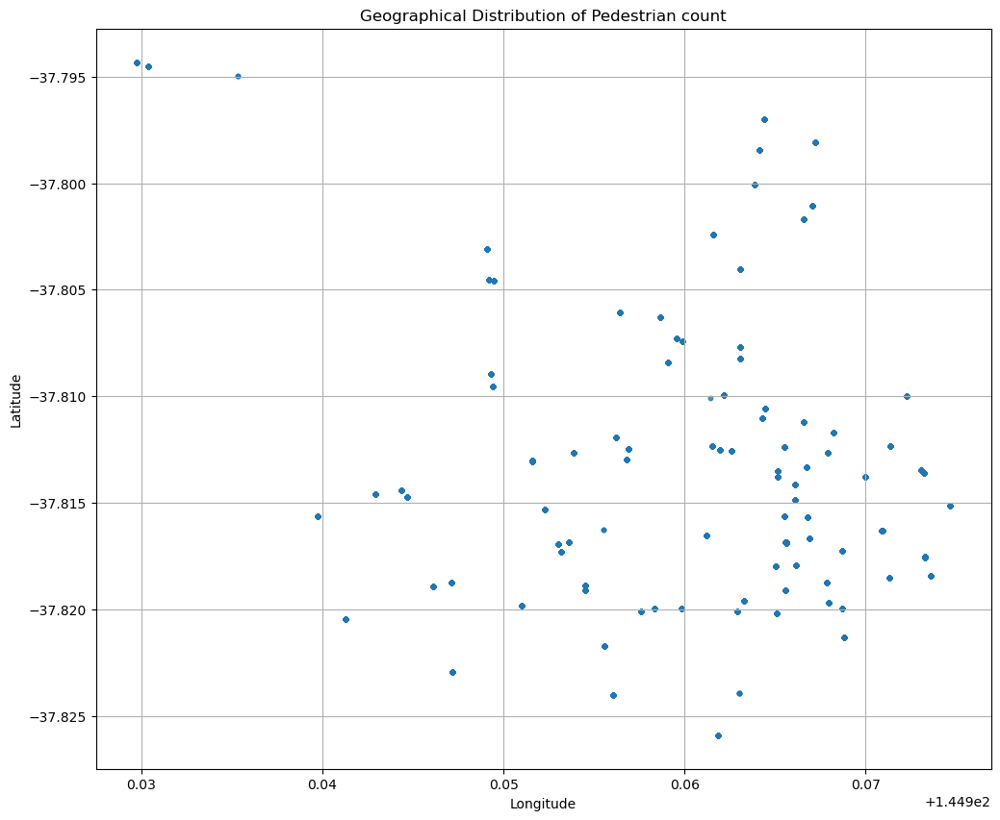

In [54]:


plt.figure(figsize=(12, 10))
plt.scatter(pedestrian_counting_df['longitude'],pedestrian_counting_df['latitude'], alpha=0.5, s=10)
plt.title('Geographical Distribution of Pedestrian count')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

As seen with the results we cans see that there is a good spread of pedestrian count sensors throought the city. This is great news as it will ensure that we can reliably use the sensor data.  

### Visualisation of Pedestrian Counts by Location  

**Description:** 

-The code cell below plots a bar plot of all the sensor locaitons using matplotlib. This will provide us with the visual representation of the more frequented locations within melbourne. 

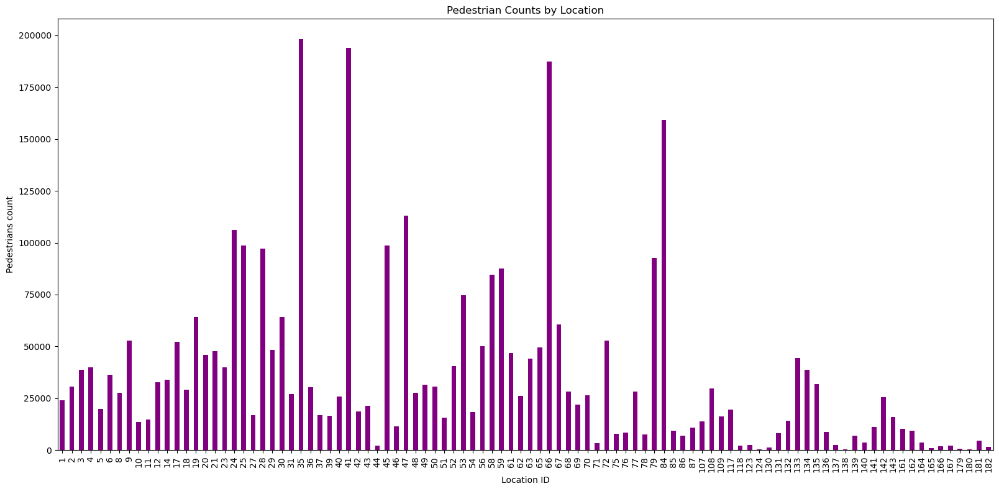

In [57]:
pedestrian_count_location_d = pedestrian_counting_df.groupby('location_id')['pedestriancount'].sum() 

pedestrian_count_location_d.plot(kind='bar', figsize=(16, 8), color='purple')
plt.title("Pedestrian Counts by Location")
plt.xlabel("Location ID")
plt.xticks(rotation = 90)
plt.tight_layout()
plt.ylabel("Pedestrians count")
plt.show()


From the Graph: 
* we can see the location id in which there is the greatest foot traffic present 
* we can also see the locations in which the least amount of foot traffic exists
* some stand out location id are ID 35, 24, 41,47,59, 66, 84 for the largest amount of foot traffic in either direction 
* low foot traffic regions can be see as ID 10, 44, 46, 51, 71, 75, 76, 78, 118 etc 

### Importing Landmark Data 
Several key tasks are completed to prepare landmark dataset for future analysis. Firstly the Dataset is retrieved it is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from co_ordinates. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if co_ordinates is a valid dcitionary. 
Finally a prieview of the code is created with .head(). unique landmarks is printed to see the different landmarks which are incorrportate into the dataset. implemented describe to understand the dataset for any EDA. 

In [60]:
# Fetch dataset 
landmarks = fetch_data(BASE_URL, 'landmarks-and-places-of-interest-including-schools-theatres-health-services-spor' , API_KEY)
landmarks['latitude'] = landmarks['co_ordinates'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)
landmarks['longitude'] = landmarks['co_ordinates'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
unique_landmarks = landmarks['theme'].drop_duplicates() 
print(unique_landmarks)
print(landmarks.describe())
print(landmarks.head())
# Create a new row named latitude

0                                 Transport
1                                 Mixed Use
2                        Leisure/Recreation
3                          Place of Worship
13                          Health Services
14                            Community Use
18                        Place Of Assembly
21                                   Office
30                            Purpose Built
31                              Vacant Land
35                         Education Centre
46                Residential Accommodation
59                          Warehouse/Store
112    Specialist Residential Accommodation
179                                  Retail
225                              Industrial
Name: theme, dtype: object
         latitude   longitude
count  242.000000  242.000000
mean   -37.812141  144.961306
std      0.012365    0.017296
min    -37.848520  144.908191
25%    -37.821102  144.953549
50%    -37.813219  144.965589
75%    -37.803816  144.972796
max    -37.781268  144.989401

The EDA provides useful information as the number of unique landmarks which exist this will provide useful when implementing the adequate saftey score based on the landmark. Furthermore, we get a good scope into the data there are 242 data points. These datapoints will provide useful to help with the lack of street light data within the city.  

### Visualising Landmarks 
Viewing the landmarks on the map gives a good respresentation of the provided landmarks and the locations in which each land marks exist. 
The map contains unique Icons for each landmark and if you click on the icon it provides the description of the landmark.

In [149]:
# Map centered on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=13)



# Assigned appropriate icons to each landmark theme 
theme_icons = {
     "Transport": ("train", "blue"),
    "Mixed Use": ("building", "gray"),
    "Leisure/Recreation": ("tree", "green"),
    "Place of Worship": ("university", "purple"),
    "Health Services": ("plus-square", "red"),
    "Community Use": ("users", "darkblue"),
    "Place Of Assembly": ("paint-brush", "darkpurple"),
    "Office": ("briefcase", "lightgray"),
    "Purpose Built": ("cogs", "cadetblue"),
    "Vacant Land": ("ban", "black"),
    "Education Centre": ("graduation-cap", "orange"),
    "Residential Accommodation": ("home", "lightgreen"),
    "Warehouse/Store": ("archive", "beige"),
    "Specialist Residential Accommodation": ("bed", "lightred"),
    "Retail": ("shopping-cart", "pink"),
    "Industrial": ("industry", "darkred")
}

#iterate through the landmarks dataframe 
for _, row in landmarks.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        info_text = row['feature_name']
        theme = row['theme']
        icon_name, colour = theme_icons.get(theme, ("info-sign", "gray"))
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup= info_text,
            icon= folium.Icon(icon=icon_name, prefix= "fa", color=colour)
        ).add_to(m)

# adding legends with HTML  

legend_html = """
<link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/6.4.0/css/all.min.css">
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 300px; height: 400px;
            background-color: rgba(255, 255, 255, 0.8); border:2px solid grey; z-index:1000; font-size:14px;
            padding: 10px;">
<b>Legend</b><br><br>
<i class="fa fa-train" style="color:blue"></i> Transport<br>
<i class="fa fa-building" style="color:gray"></i> Mixed Use<br>
<i class="fa fa-tree" style="color:green"></i> Leisure/Recreation<br>
<i class="fa fa-university" style="color:purple"></i> Place of Worship<br>
<i class="fa fa-plus-square" style="color:red"></i> Health Services<br>
<i class="fa fa-users" style="color:darkblue"></i> Community Use<br>
<i class="fa fa-paint-brush" style="color:darkpurple"></i> Place Of Assembly<br>
<i class="fa fa-briefcase" style="color:lightgray"></i> Office<br>
<i class="fa fa-cogs" style="color:cadetblue"></i> Purpose Built<br>
<i class="fa fa-ban" style="color:black"></i> Vacant Land<br>
<i class="fa fa-graduation-cap" style="color:orange"></i> Education Centre<br>
<i class="fa fa-home" style="color:lightgreen"></i> Residential Accommodation<br>
<i class="fa fa-archive" style="color:beige"></i> Warehouse/Store<br>
<i class="fa fa-bed" style="color:lightred"></i> Specialist Residential Accommodation<br>
<i class="fa fa-shopping-cart" style="color:pink"></i> Retail<br>
<i class="fa fa-industry" style="color:darkred"></i> Industrial<br>
</div>
"""
 
m.get_root().html.add_child(folium.Element(legend_html))


# Show map
m 

#### What can we see
* The spread of the key landmarks within melbourne 
* What landmarks exisit within the city 
* Better understanding on what steps to take to assign landmark score values  


### Landmark score 

Below the landmark saftey score is assigned to each of the key landmarks within the dataset. The scoring is determined by the type of land use and its impact on pedestrian activity, lighting and surveillance. Locations such as health services, education centres and community hubs have received an increased score due to the frequent foot traffic and established infrastructure present in those locations. On the other hand locations such as vacant lands, warehouses and industrial zones are assined lower scores due to lower pedestrian activity, reduced visibility and underutilisation. Furthermore these areas during the night are often not visited and remain empty. This scoring enables us to quantify various landmarks and how they contribute or detract from the night time safety in Melbourne. 

In [66]:
#The landmark score is a dictionary with the key as the landmark theme and score as the safety rating provided. 
landmark_score = {
    'Transport': 2, 
    'Health Services': 3, 
    'Education Centre': 2, 
    'Place of Worship': 2, 
    'Leisure/Recreation': 1, 
    'Community Use': 3, 
    'Residential Accommodation': 2, 
    'Specialist Residential Accommodation': 1,
    'Retail': 2, 
    'Vacant Land': -1, 
    'Office' : 1, 
    'Warehouse/Store': 0, 
    'Mixed Use': 1, 
    'Purpose Built': 1, 
    'Industrial': 0,
    'Place Of Assembly': 2
}
#The score is then mapped to the landmarks data with a new column named safety_score with the appropriate score. 
landmarks['safety_score'] = landmarks['theme'].map(landmark_score).fillna(0) 
landmarks

,theme,sub_theme,feature_name,co_ordinates,latitude,longitude,safety_score
0,Transport,Railway Station,Flemington Bridge Railway Station,"{'lon': 144.939277838304, 'lat': -37.788164588...",-37.788165,144.939278,2
1,Mixed Use,Retail/Office/Carpark,Council House 2 (CH2),"{'lon': 144.966638432727, 'lat': -37.814259143...",-37.814259,144.966638,1
2,Leisure/Recreation,Informal Outdoor Facility (Park/Garden/Reserve),Carlton Gardens South,"{'lon': 144.971266479841, 'lat': -37.806068457...",-37.806068,144.971266,1
3,Place of Worship,Church,Wesley Church,"{'lon': 144.968168215633, 'lat': -37.810157644...",-37.810158,144.968168,2
4,Place of Worship,Church,St Augustines Church,"{'lon': 144.954862000132, 'lat': -37.816974135...",-37.816974,144.954862,2
...,...,...,...,...,...,...,...
237,Education Centre,School - Primary and Secondary Education,Melbourne Girls Grammar School,"{'lon': 144.985089428348, 'lat': -37.831536451...",-37.831536,144.985089,2
238,Retail,Department Store,Myer,"{'lon': 144.963855087868, 'lat': -37.813591198...",-37.813591,144.963855,2
239,Retail,Department Store,David Jones,"{'lon': 144.964373486798, 'lat': -37.813312726...",-37.813313,144.964373,2
240,Health Services,Medical Services,Mercy Private Hospital,"{'lon': 144.984435746587, 'lat': -37.811896809...",-37.811897,144.984436,3


Another row is attached named saftey_score in which it stores the net saftey score fo each location determened on the theme of the location the location weight has been assigned as per documentation of crime events within melbourne and areas which are perceived safe due to there increased foot traffic and use at all hours of the day. Office where scored lower as are often empty after hours. This data will aid in provided a much needed information to incorporate into the night_time safety index. 

#### Visualisation of Safety Score Distribution 

**Description:** 
The code cell implements a Bar graph of the Saftey Score for each landmark, with a clear visual representation of the spread of the data based ont he landmark. 

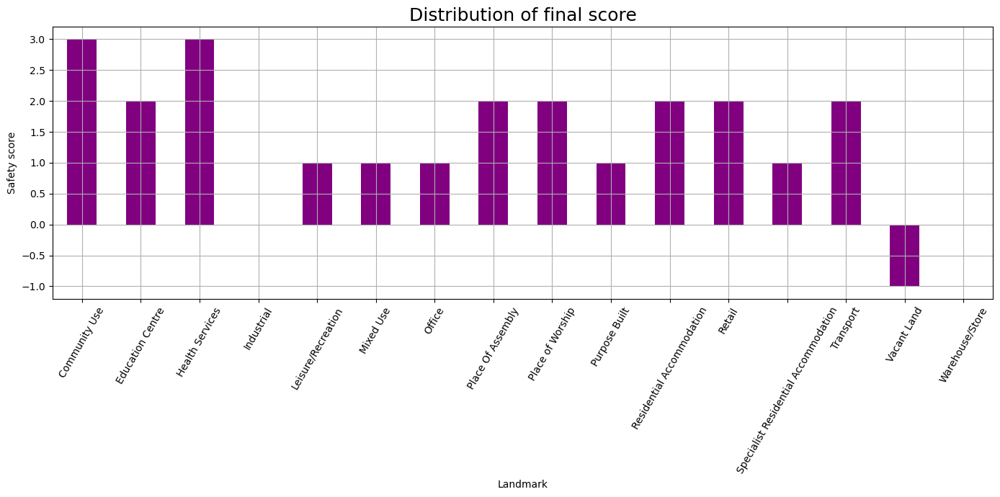

In [69]:
#EDA on safety score spread 
safety_score_theme = landmarks.groupby('theme')['safety_score'].mean()

safety_score_theme.plot(kind='bar', figsize=(14, 7), color='purple')
plt.title("Distribution of final score", fontsize = 18) 
plt.xlabel("Landmark")
plt.ylabel("Safety score")
plt.xticks(rotation=60)
plt.tight_layout()
plt.grid(True)
plt.show()

Areas that are low value are Warehouse/store and industrial with a value of 0. With the only negative score assigned to vacant land.  

### Importing bus stop data 
Several key tasks are completed to prepare the bus stop dataset for future analysis. Firstly the Dataset is retrieved the dataset is imported using the Melbourne Open Data v2.1 API, ensuring all the data is up to date. The first steps taken are Coordinate Extraction. In which the geo_point_2d row stores the lat and lon data in a dictionary format new coloumns are created with longitude and latitude both extract from geo_point_2d. 
The data is validated so that is ensured that is clean and ready for mapping. The rows are checked for if geo_point_2d is a valid dcitionary. 
Finally a prieview of the code is created with .head() 

In [72]:
# Data set names
dataset_bus_stops = 'bus-stops'
# Fetch dataset 
bus_stops_df = fetch_data(BASE_URL, dataset_bus_stops, API_KEY)
# Create a new row named latitude
bus_stops_df['latitude'] = bus_stops_df['geo_point_2d'].apply(lambda x: x['lat'] if isinstance(x, dict) else None)
# Create a new row name longitude 
bus_stops_df['longitude'] = bus_stops_df['geo_point_2d'].apply(lambda x: x['lon'] if isinstance(x, dict) else None)
print(bus_stops_df.describe())
print(bus_stops_df.head())

             prop_id  addresspt1  addressp_1      objectid        str_id  \
count     309.000000  309.000000  309.000000    309.000000  3.090000e+02   
mean     6405.006472   25.802489  175.258900  23327.242718  1.296812e+06   
std     58324.056187   20.458442  109.574787  13112.345496  1.110742e+05   
min         0.000000    0.000000    0.000000    303.000000  1.231165e+06   
25%         0.000000   10.980840   88.000000  12390.000000  1.239533e+06   
50%         0.000000   21.561304  175.000000  22943.000000  1.249163e+06   
75%         0.000000   35.066244  268.000000  35532.000000  1.257190e+06   
max    627016.000000   98.326608  360.000000  44401.000000  1.581811e+06   

             mcc_id    roadseg_id    latitude   longitude  
count  3.090000e+02    309.000000  309.000000  309.000000  
mean   1.296812e+06  21305.511327  -37.810139  144.953007  
std    1.110742e+05   3107.476239    0.015279    0.019688  
min    1.231165e+06      0.000000  -37.850563  144.900324  
25%    1.239533

### Safety score assignment and Cleaning

`bus_stop_simplified`is created an incorporates key elements of `bus_stops_df`, whilst disregarding unnecessary information. Then a safety score of 2 assigned to a new column safety score in which the same score is assigned througout the dataset. 

As bus stops are often higher traffic area and are often located in wide open spaces the rating is 2. 

In [74]:
bus_stops_simplified = bus_stops_df[['objectid', 'latitude', 'longitude']].copy() 
bus_stops_simplified['safety_score'] = 2

print(bus_stops_simplified)

     objectid   latitude   longitude  safety_score
0         749 -37.818425  144.968896             2
1        2098 -37.817676  144.958882             2
2        2143 -37.781889  144.959632             2
3        2627 -37.793727  144.947167             2
4        3306 -37.802862  144.927785             2
..        ...        ...         ...           ...
304     44096 -37.799877  144.950054             2
305     44103 -37.822043  144.961272             2
306     44170 -37.846370  144.984817             2
307     44287 -37.810347  144.961123             2
308     44401 -37.797553  144.974887             2

[309 rows x 4 columns]


#### Geospatial Visualisation of Bus Stops 

**Description:** 
The code cell below plots all the location of the bus stops within the `bus_stops_df` as a scatter plot. This will server as a visual representation of the spread of the data and aid in decisions based on the 
bus stop datasets.

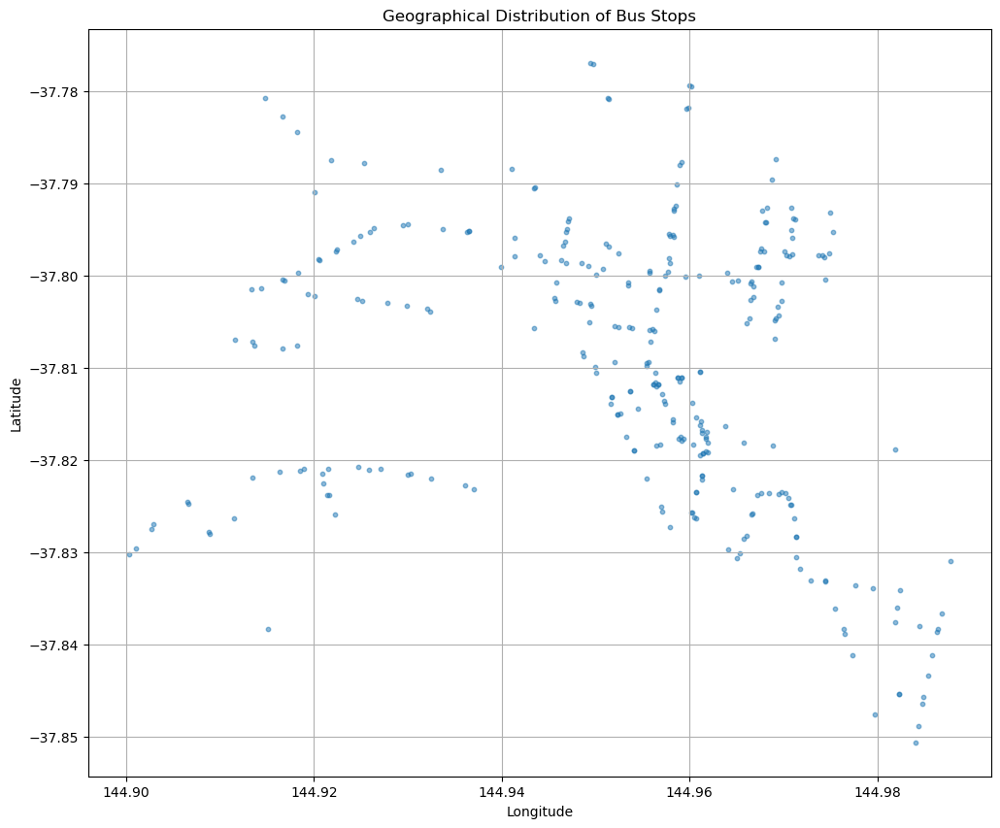

In [76]:


plt.figure(figsize=(12, 10))
plt.scatter(bus_stops_df['longitude'],bus_stops_df['latitude'], alpha=0.5, s=10)
plt.title('Geographical Distribution of Bus Stops')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()


As seen by the scatter plot the spread demonstrates how well distributed the bus stop data is. 

### Visualising Dataset using folium 
I have iterated through each of the datasets and coloured the elements respectfully blue: bus stops, red: pedestrian count sensor location, yellow: street lights. This provides a visual guid to understand the location of each of the street lights, location of each of the bus stops and the location of each of the pedestrain sensors with this informaiton we can get a better understanding on how to further progress on the project what data is scarse and what areas need more data sources to produce reliable information. 

In [151]:
# Center map on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=13)

# Add markers from the dataset bus_stops_df
for _, row in bus_stops_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='blue',
            fill=True
        ).add_to(m)

# Add markers for the city cirlcle tram stop 
for _, row in city_circle_tram_stops.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=4,
            color='green',
            fill=True
        ).add_to(m)




# Add markers from the dataset pedestrian_counting_df
for _, row in pedestrian_counting_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=3,
            color='red',
            fill=True
        ).add_to(m)

# Add markers from the dataset street_lighting_df
for _, row in street_light_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='yellow',
            fill=True
        ).add_to(m)

# Add markers from the dataset feature_light_df
for _, row in feature_light_df.iterrows():
    if pd.notnull(row['latitude']) and pd.notnull(row['longitude']):
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=2,
            color='yellow',
            fill=True
        ).add_to(m) 

# Add legend
legend_html = """
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 150px; height: 120px;
            background-color: rgba(255, 255, 255, 0.8); border:2px solid grey; z-index:1000; font-size:12px;
            padding: 10px;">
<b>Legend</b><br>
<i style="background:blue; width:10px; height:10px; display:inline-block; border-radius:50%;"></i>&nbsp;Bus Stops<br>
<i style="background:green; width:10px; height:10px; display:inline-block; border-radius:50%;"></i>&nbsp;Tram Stops<br>
<i style="background:red; width:10px; height:10px; display:inline-block; border-radius:50%;"></i>&nbsp;Pedestrian Counters<br>
<i style="background:yellow; width:10px; height:10px; display:inline-block; border-radius:50%;"></i>&nbsp;Street Lights<br>
</div>
"""
m.get_root().html.add_child(folium.Element(legend_html))

# Show map
m



### Visualisation Summary of Spatial Data

The output generated is an interactive map of the Melbourne CBD featuring:

- **Yellow dots**: Locations of council-owned **street lights**  
- **Blue dots**: **Bus stop** locations  
- **Red dots**: **Pedestrian sensor** locations  

From the map, several key insights can be drawn:

- Street light coverage is uneven across the city. Lighting is heavily concentrated in certain zones while some areas are noticeably lacking.  
- Pedestrian sensors are installed only at specific points, which means that pedestrian traffic data is not uniformly available city-wide.  
- This limitation highlights the need for extrapolation and data augmentation in areas lacking direct measurements .
- Visualising this spatial data has proven to be highly informative it provides critical context to guide the design of a more accurate Night-Time Safety Index.

The visualisation acts as both a planning tool to better understand urban safety infrastructure coverage.

### Grouping by Latitude and Longitude Grid Bins 

This section of the notebook prepares all of the datasets for merging and incorporates the street light density into the **Night-Time Safety Index** calclualtion.

**Description:** 
1. **Safety Score Renaming** 
- Every dataset's `safety_score` has to changed to an appropriate unique identifier so that the data may be merged into a singular dataset. 

2. **Location Binning** 
- All datasets have been allocated latitude and longitude bins of precision 4, which is a rounding precision which works out to 11 meters. The spatial bins will aid in the implementation of merging features as per there proximity. The location binning has also aided in the impplementation of the light density. 

3. **Light Density** 
- light density was implemented to account for the amount of light within a location bin if the weightage of the light was low but there are many lights it would account for the low wattage. To implement this
- I have first combined both light datasets into one. This allows for there to be one set of lat and lon bin. I then grouped the data by lat_bin and long_bin by size as there would be in some cases overlapping light data within the same location bin. I then put the size into a new column light density. 
- The light data was then normalised so that it would not skew the data heavily in favour of light density as some locations had high light density. Light density safety score would not exceed a value of 4 with a min of 0 to keep it in range with other safety scores. 

4. **Safety Feature Consolidation**  
- A list of simplified dataframes is created, each containing `lat_bin`, `lon_bin`, and its respective safety-related score. These will later be merged to compute the **final safety score per grid cell**.

In [82]:
#safety score is renamed so that it can be combined into one dataset and identified as an individual score.
bus_stops_simplified = bus_stops_simplified.rename(columns={'safety_score': 'bus_score'})
landmarks = landmarks.rename(columns={'safety_score': 'landmark_score'})
pedestrian_count_location = pedestrian_count_location.rename(columns={'safety_score': 'ped_score'})
city_circle_tram_stops = city_circle_tram_stops.rename(columns={'safety_score': 'tram_score'})
feature_light_df = feature_light_df.rename(columns={'safety_score': 'feature_light_score'})
street_light_df = street_light_df.rename(columns={'safety_score': 'street_light_score'}) 

def assign_location_bins(df, lat_col='latitude', lon_col='longitude', precision=4):
    
    df['lat_bin'] = df[lat_col].round(precision)
    df['lon_bin'] = df[lon_col].round(precision)
    return df

bus_stops_simplified = assign_location_bins(bus_stops_simplified)
landmarks = assign_location_bins(landmarks)
pedestrian_count_location = assign_location_bins(pedestrian_count_location)
city_circle_tram_stops = assign_location_bins(city_circle_tram_stops)
feature_light_df = assign_location_bins(feature_light_df)
street_light_df = assign_location_bins(street_light_df)


# calculating light density  to incorporate into the index 
#combines both light datasets based on the lat and lon bin 
all_lights_df = pd.concat([feature_light_df[['lat_bin', 'lon_bin']], street_light_df [['lat_bin', 'lon_bin']]]) 
#discover the number of lights within a grid box and attach it to a new column light_density 
light_density = all_lights_df.groupby(['lat_bin', 'lon_bin']).size().reset_index(name='light_density')

# the light density is normalised with a range from 1- 4 
light_density['light_density'] = light_density['light_density'].apply(
    lambda x: 1 if x < 5 else 2 if x < 10 else 3 if x < 20 else 4 if x < 1000 else 1
)

# New list is created with lat_bin, lon_bin and the safety score for each dataset
dfs = [df[['lat_bin', 'lon_bin', col]] for df, col in [
    (bus_stops_simplified, 'bus_score'),
    (landmarks, 'landmark_score'),
    (pedestrian_count_location, 'ped_score'),
    (city_circle_tram_stops, 'tram_score'),
    (feature_light_df, 'feature_light_score'),
    (street_light_df, 'street_light_score'),
    (light_density, 'light_density')
]]

### Merging Datasets & Final Safety Score Calculation 

This section of the notebook, all safety scores from the previous datasets are merged into a one dataframe and the final_safety_score is calculated for each location bin. 

**Description:** 
 
 1. **Merging Safety Score from Datasets:** 
- Using a combination of the `reduce` and `.merge()` method within Python. all the datasets from the dfs list are then moved into `combined_df`. All data with lat_bin and long_bin arem merfed on shared grid values. 

2. **Final Safety Score Calculation:** 
- The final Safety Score is calulated by taking the mean value of all of the safety scores of the various datasets and normalised light_density value.  
- The combined score provides a comprehensive safety rating for each location based on multiple features. 


In [84]:

combined_df = reduce(lambda left, right: pd.merge(left, right, on=['lat_bin', 'lon_bin'], how='outer'), dfs)

# Fill missing values with 0 to not cause any errors 
combined_df = combined_df.fillna(0)

# Compute final safety score as the average of all sources
combined_df['final_safety_score'] = combined_df[
    
    ['bus_score', 'landmark_score', 'ped_score', 'tram_score', 'feature_light_score', 'street_light_score', 'light_density']
].mean(axis=1, skipna= False)
combined_df

,lat_bin,lon_bin,bus_score,landmark_score,ped_score,tram_score,feature_light_score,street_light_score,light_density,final_safety_score
0,-37.8506,144.9840,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.285714
1,-37.8488,144.9844,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.285714
2,-37.8485,144.9822,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.285714
3,-37.8476,144.9797,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.285714
4,-37.8464,144.9848,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.285714
...,...,...,...,...,...,...,...,...,...,...
20568,-37.7754,144.9389,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.428571
20569,-37.7754,144.9389,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.428571
20570,-37.7754,144.9389,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.428571
20571,-37.7754,144.9389,0.0,0.0,0.0,0.0,0.0,1.0,2.0,0.428571


combined_df has successfully outputed the final_safety score as well of all the scores in which the final safety score is derived from. 

### EDA on `final_safety_score` 
Exploritory data analysis is done on the final safety score to ensure the spread of values is reasonalbe and so that there are no extreme outliers. 
This ensures that the final safety score has functioned as intended and the results have been successful. 

In [87]:
print(combined_df['final_safety_score'].describe())

count    20573.000000
mean         0.482831
std          0.191851
min         -0.142857
25%          0.285714
50%          0.428571
75%          0.571429
max          1.285714
Name: final_safety_score, dtype: float64


Looking at the results we can see that there are 20573 location grids, with a mean final_safety_score: 0.48 this further dispalays the spread of the data is well distributed. We can see the max final safety score is 1.29 and the min is -0.14. 

### Visualisation on the Distribution of Final Safety Score 

The cell below provides a histogram of the distribution of values so that is to ensure the spread is even. 

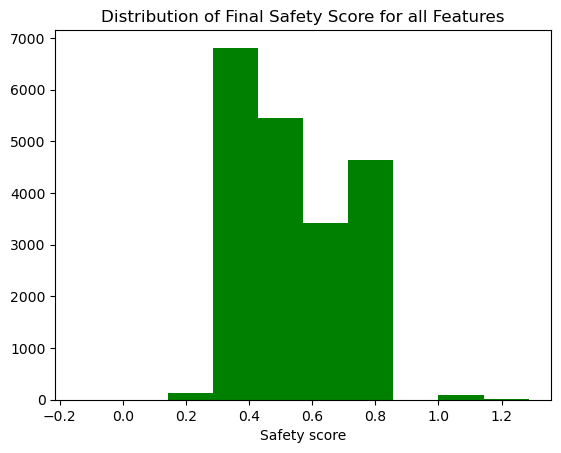

In [92]:
plt.hist(combined_df['final_safety_score'], bins=10, color= 'green') 
plt.title("Distribution of Final Safety Score for all Features") 
plt.xlabel("Safety score")
plt.show()

The spread of the data is well distributed and reflects the results obtained earlier.  

### Heatmap Visualisation of Final Safety Score

This section generates an interactive heatmap to visualise the calculated `final_safety_score` across Melbournes city.

#### Description:
- A **Folium map** is created, centered on Melbourne's CBD.
- The `heat_data` list extracts the `lat_bin`, `lon_bin`, and corresponding `final_safety_score` from the `combined_df` dataframe.
- A heat layer is added using `folium.plugins.HeatMap()`, where:
  - Each point on the map corresponds to a geographic bin (rounded lat/lon).
  - The **intensity of the heat** is based on the `final_safety_score`, highlighting areas of varying night-time safety.
  - Higher scores produce a "hotter" (brighter) color, typically representing **safer** areas.

This heatmap provides an intuitive geospatial understanding of the night time safety index. 

In [163]:


# Create a base map centered on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=13)

# Add heatmap layer using final safety score
heat_data = [
    [row['lat_bin'], row['lon_bin'], row['final_safety_score']]
    for _, row in combined_df.iterrows()
        
]

HeatMap(heat_data, radius=15).add_to(m) 

legend_html = """
<link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/6.4.0/css/all.min.css">
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 200px; height: 200px;
            background-color: rgba(255, 255, 255, 0.8); border:2px solid grey; z-index:1000; font-size:14px;
            padding: 10px;">
<b>Safety Score Legend</b><br><br>
    <i style="background: red; width:18px; height: 10px; float: left; margin-right: 8px;"></i> Very High (Safe)<br>
    <i style="background: orange; width: 18px; height: 10px; float: left; margin-right: 8px;"></i> High<br>
    <i style="background: yellow; width:18px ; height:10px; float: left; margin-right: 8px; "></i> Moderate<br>
    <i style="background: lightgreen; width: 18px; height: 10px; float: left; margin-right: 8px;"></i> Low<br>
    <i style="background: green; width: 18px; height: 10px; float: left; margin-right: 8px; "></i> Very low (UnSafe)<br>
</div>
"""
 
m.get_root().html.add_child(folium.Element(legend_html))

m

### Explanation 

The heat map provides a clear outline of areas of which that are considered safe, As seen these locations are marked in red and and the darker blue areas indicate areas that are less safe. The grid doesnt cover the whole of melbourne as seen by the map but provides a good overview of location that do cover it regions not covered dont have any colouring present. We can see that the main regions in which the heatmap indicates are safe are near trainstations is working as expected, we can see a clearly see the areas which are red and busy higher traffic areas. The Docklands area performs significantly well as the featured light data is present within that location, as well as the density of light within that region has awarded it a higher value. 

## Conclusion: Night Time Safety Index

The Night Time Safety Index provides a data-driven solution to evaluating perceived and infrastructural safety across Melbourne during nighttime hours. By compiling multiple open datasets including pedestrian traffic, featured lighting, council owned street lighting, bus stop, city circle tram stops and public landmarks constructed a geospatial index that captures both activity levels and environmental safety factors.

Through feature engineering and location grid binning, I was able to normalize datasets and generate a combined safety score for each location grid. The resulting heatmap clearly highlights areas of concern, as well of areas in which good industrial development has taken palce and which are safer. 

The index is not only limited to use for individuals who are travelling at night and would like to avoid areas which are dangerous or individuals who are trying to get home safely. It provides an insight into safety within the community to city planners and local authorities in determining the gaps in safety. There is still so much to explore with the night time safety index. When developing the index I had a large part of the city lighting data missing, as of a resault I had contacted City of Melbourne to find access to the light data, but was unfortunatly unable to recieve the data in time. With the completed dataset it will provide a more accurate night time safety index further improving the safety index. 

This index serves as a foundation for future enhancements such as incorporating real-time incident reports or machine learning models to predict safety fluctuations.
Finally, the Night Time Safety Index is a scalable framework that promotes smarter, safer urban environments through transparent, open data analytics.
